# **Лабораторная работа 2**

В данном задании вашей задачей будет построить и обучить модель CycleGAN для задачи Img2Img.

---

Про задачу __Img2Img__:

- У вас есть 2 множества изображений ($A$ и $B$)
- Ваша задача - научиться превращать изображения из множества $A$ в изображения из множества $B$ и наоборот
- Бывают paired и unpaired множества
- В случае __paired__ множеств - для каждого изображения из $A$ существует конкретное изображение из $B$, в которое оно должно перейти (и наоборот). Примером такой пары множеств может быть (а) спутниковая фотграфия местности vs схематическая карта местности , (б) фотография фасада здания vs схема фасада здания , ...
- В случае __unpaired__ множеств - между множествами нет конкретных пар. Примером такой пары множеств может быть (а) фотографии с лошадьми vs фотографии с зебрами , (б) фотографии vs рисунки конкретного художника , ...

---

Про модель __CycleGAN__:

- Модель придумана для задачи Img2Img (в первую очередь unpaired версии) и основана на концепции GAN-ов
- В модели есть 2 генератора: $G_{A -> B}$ (задача которого - принимая на вход изображение из множества $A$ переводить его в изображение из множества $B$) и $G_{B -> A}$ (аналогично в другую сторону)
- Надо отметить что на вход генераторы не получают никакую дополнительную случайность, что делает обучение таких моделей проще
- В модели так же есть 2 дискриминатора: $D_{A}$ (задача которого - отличать реальные изображения из $A$ от сгенерированных с помощью $G_{B -> A}$ изображений) и $D_{B}$ (аналогично для $B$)
- Функцией ошибки будет, как и для GAN-ов, minmax игра между генераторами и дискриминаторами, но к ошибке генераторов добавится ещё и, так называемый, `cycle consistency loss`, который проверяет, что после двойного перехода изображения не меняются $G_{B -> A} \big( G_{A -> B} ( a ) \big) = a ; \forall a \in A$ и $G_{A -> B} \big( G_{B -> A} ( b ) \big) = b ; \forall b \in B$
- Так же можно добавлять или нет штраф за то, чтобы $G_{B -> A}$ не меняла изображения из $A$ и наоборот $G_{A -> B}$ не меняла изображения из $B$
- Оригинальная статья: https://arxiv.org/pdf/1703.10593.pdf

---

Ваша задача - ноутбук разбит на несколько частей, каждая со своими баллами

1. __Подготовка данных__ _(2 балла)_ --> требуется выбрать датасет для обучения (дано несколько на выбор) и составить пайплайн подготовки данных
2. __Составление модели__ _(6 баллов)_ --> требуется собрать нейросеть _(3 балла)_ и создать функции ошибки _(3 балла)_
3. __Подготовка обучения__ _(2 балла)_ --> требуется написать шаги обучения и валидации, визуализацию, а так же полный цикл обучения
4. __Обучение__ _(2 балла)_ --> требуется обучить модель
5. __Сбор своего датасета и обучение модели на нём__ _(3 балла)_ --> требуется собрать свой датасет и обучить на нём модель

***За наиболее интересные и качественные решения в пункте 5 так же предусмотрены дополнительные баллы***

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ExponentialLR

from torchvision import datasets, transforms as tr

import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

from tqdm.auto import tqdm, trange

import os
import sys
import requests
import cv2
import shutil
import requests
import zipfile

from dataclasses import dataclass

# 1. Подготовка данных (___2 балла___)

## 1.1 Выбор и скачивание датасета

In [2]:
file_path = r"C:\home\jupyter\datasphere\project\datasets\summer2winter_yosemite.zip"
print(os.path.exists(file_path))

True


Dataset 'summer2winter_yosemite'
Unzipping... --> done!
Provided splits: ['summer2winter_yosemite', 'testA', 'testB', 'trainA', 'trainB']
Split 'summer2winter_yosemite' of dataset 'summer2winter_yosemite' --> size: 4


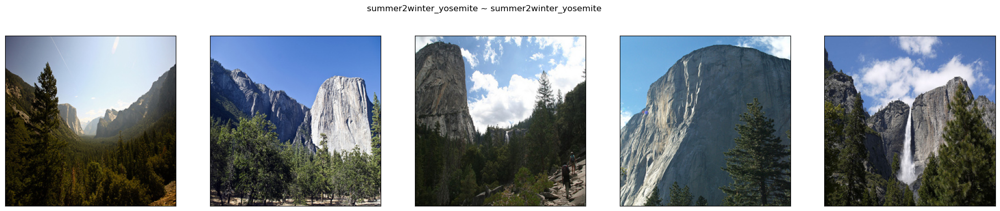

Split 'testA' of dataset 'summer2winter_yosemite' --> size: 309


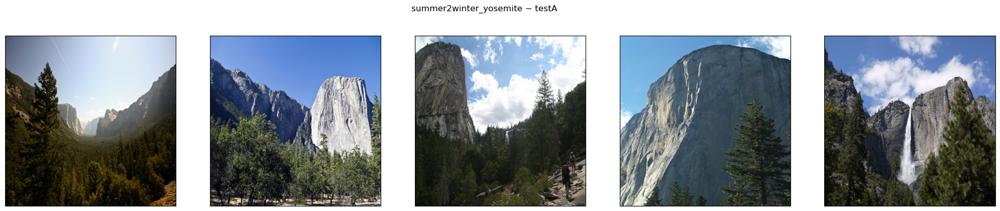

Split 'testB' of dataset 'summer2winter_yosemite' --> size: 238


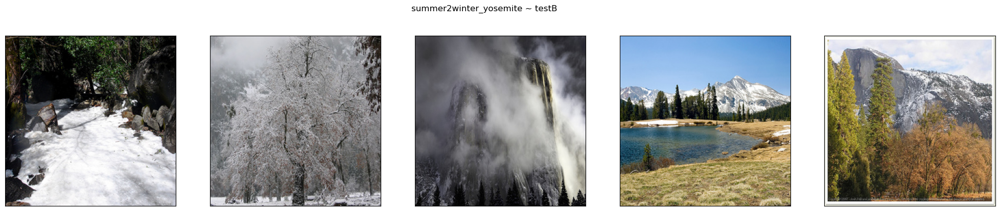

Split 'trainA' of dataset 'summer2winter_yosemite' --> size: 1231


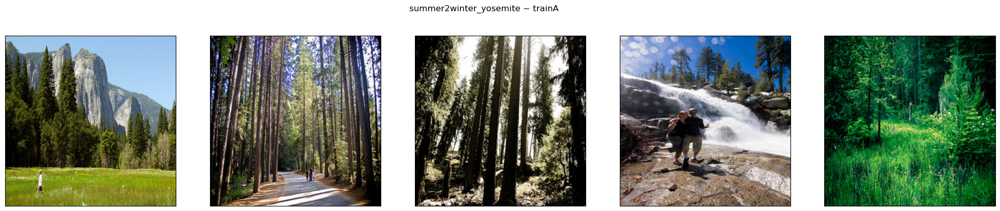

Split 'trainB' of dataset 'summer2winter_yosemite' --> size: 962


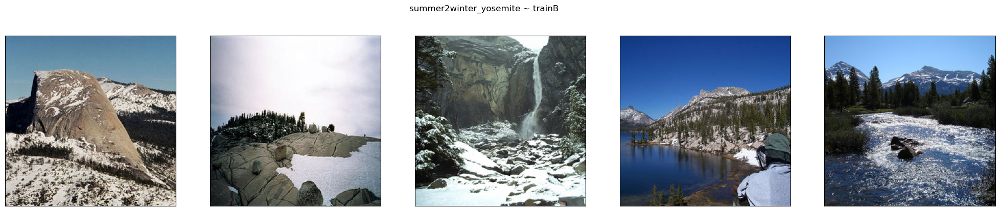


----------------------------



In [3]:
num_images_per_split = 5
dataset_folder = r"C:\home\jupyter\datasphere\project\datasets"

for dataset_name in [
    # Unpaired
    #"apple2orange",
    "summer2winter_yosemite",
    #"horse2zebra",
    #"monet2photo",
    #"cezanne2photo",
    #"ukiyoe2photo",
    #"vangogh2photo",
    # Paired
    #"maps",
    #"facades",
]:
    print(f"Dataset '{dataset_name}'")
    zip_file_path = os.path.join(dataset_folder, f"{dataset_name}.zip")
    target_folder = os.path.join(dataset_folder, dataset_name)
    
    if not os.path.exists(target_folder):
        os.makedirs(target_folder, exist_ok=True)
    
    print("Unzipping...", end="")
    # Распаковываем архив
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(target_folder)
    print(" --> done!")
    
    # Meta + Отрисовка
    print(f"Provided splits: {os.listdir(target_folder)}")
    dataset = datasets.ImageFolder(target_folder)

    inds_to_show = {i: [] for i, _ in enumerate(dataset.classes)}
    classes_full = 0
    for dataset_ind in range(len(dataset)):
        _, split_ind = dataset[dataset_ind]
        if len(inds_to_show[split_ind]) == num_images_per_split:
            continue
        inds_to_show[split_ind].append(dataset_ind)
        if len(inds_to_show[split_ind]) == num_images_per_split:
            classes_full += 1
        if classes_full == len(dataset.classes):
            break

    for split_name in sorted(dataset.classes):
        split_ind = dataset.class_to_idx[split_name]
        print(f"Split '{split_name}' of dataset '{dataset_name}'", end="")
        split_folder = os.path.join(target_folder, split_name)
        print(f" --> size: {len(os.listdir(split_folder))}")

        plt.subplots(1, num_images_per_split, figsize=(5 * num_images_per_split, 5))
        plt.suptitle(f"{dataset_name} ~ {split_name}", y=0.95)
        for i, dataset_ind in enumerate(inds_to_show[split_ind]):
            plt.subplot(1, num_images_per_split, i + 1)
            plt.imshow(dataset[dataset_ind][0])
            plt.xticks([])
            plt.yticks([])
        plt.show()
    
    print("\n----------------------------\n")

## 1.2 Dataset и Transforms

В папке `target_folder` находятся несколько папок со сплитами для соответствующего датасета, в каждой папке сплита находятся сами `.jpg` изображения.

Давайте составим их в удобном для нас виде в отдельные датасеты для каждого сплита без лэйблов.

Для получения картинок можно использовать 
```python
cv2.imread(img_path)[:, :, ::-1]  # каналы записаны в обратном порядке
```

In [4]:
# Выбранный выше и скачанный датасет
dataset_folder = "/home/jupyter/datasphere/project/datasets"
dataset_name = "summer2winter_yosemite"
target_folder = os.path.join(dataset_folder, dataset_name)

# Класс для датасета изображений без лэйблов с применением трансформов
class ImageDatasetNoLabel(Dataset):
    def __init__(self, target_folder, transform=None):
        super(ImageDatasetNoLabel).__init__()
        self.target_folder = target_folder
        self.transform = transform
        self.image_paths = sorted([os.path.join(self.target_folder, img) for img in os.listdir(self.target_folder)])

    def __getitem__(self, index):
        img_path = self.image_paths[index] # выбираем путь до картинки с заданным индексом
        img = cv2.imread(img_path)[:, :, ::-1] # читаем картинку
        if self.transform:
            img = self.transform(img)
        return img
    
    def __len__(self):
        return len(self.image_paths)

# Удобный класс для хранения всех наших датасетов
@dataclass
class DatasetsClass:
    train_a: ImageDatasetNoLabel
    train_b: ImageDatasetNoLabel
    test_a: ImageDatasetNoLabel
    test_b: ImageDatasetNoLabel


# Все датасеты без трансформов - чтобы посчитать статистики
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(os.path.join(target_folder, "trainA")),
    train_b=ImageDatasetNoLabel(os.path.join(target_folder, "trainB")),
    test_a=ImageDatasetNoLabel(os.path.join(target_folder, "testA")),
    test_b=ImageDatasetNoLabel(os.path.join(target_folder, "testB")),
)

In [5]:
def get_channel_statistics(dataset):
    """
    Функция для получения поканальных статистик (среднее и отклонение) по датасету
    """
    channel_mean = np.zeros((3))
    channel_std = np.zeros((3))

    for idx in tqdm((range(len(dataset)))):
        img = dataset[idx]
        img = np.array(img) / 255.
        channel_mean += img.mean(axis=(0, 1))
        channel_std += img.std(axis=(0, 1))

    channel_mean /= len(dataset)
    channel_std /= len(dataset)
    return channel_mean, channel_std

# Поканальное среднее и отклонение для A
channel_mean_a, channel_std_a = get_channel_statistics(ds.train_a)
print(channel_mean_a, channel_std_a)

# Поканальное среднее и отклонение для B
channel_mean_b, channel_std_b = get_channel_statistics(ds.train_b)
print(channel_mean_b, channel_std_b)

  0%|          | 0/1231 [00:00<?, ?it/s]

[0.38509317 0.40992301 0.40588025] [0.23015862 0.22086416 0.25819884]


  0%|          | 0/962 [00:00<?, ?it/s]

[0.40305621 0.42304032 0.45276744] [0.23486796 0.23283516 0.25871264]


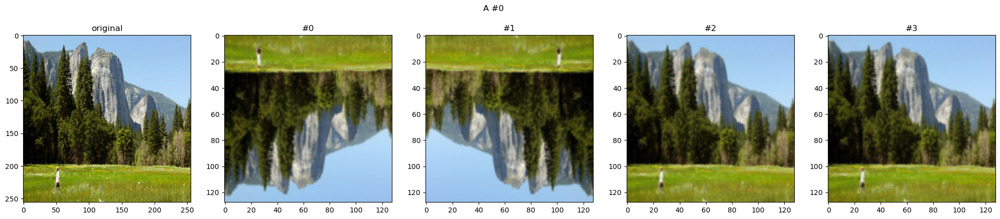

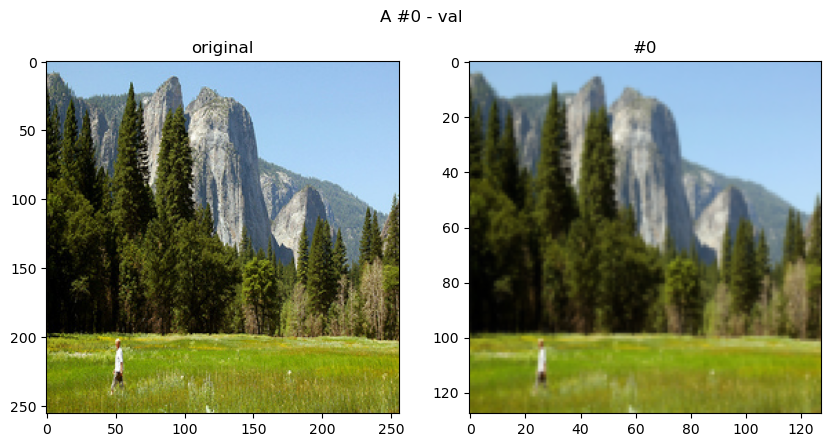

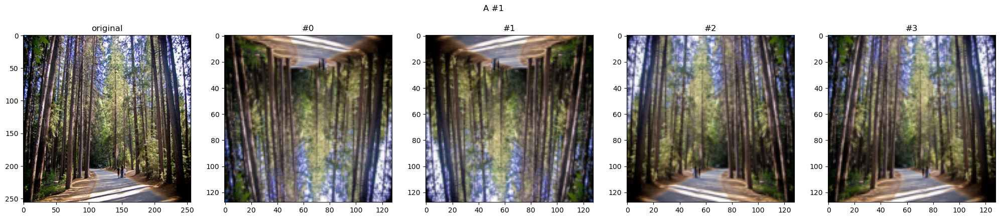

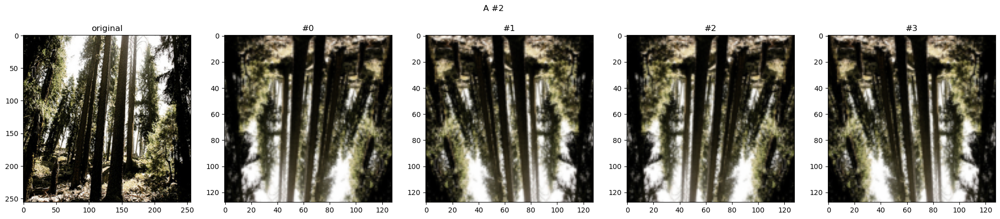

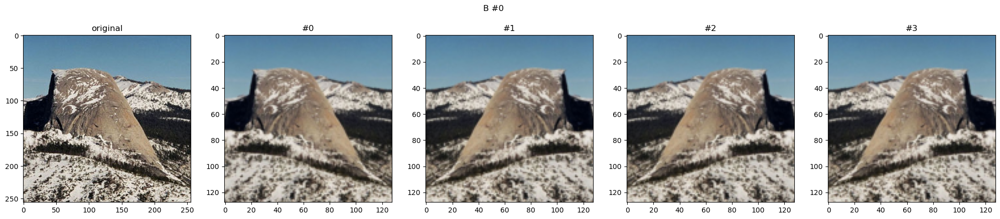

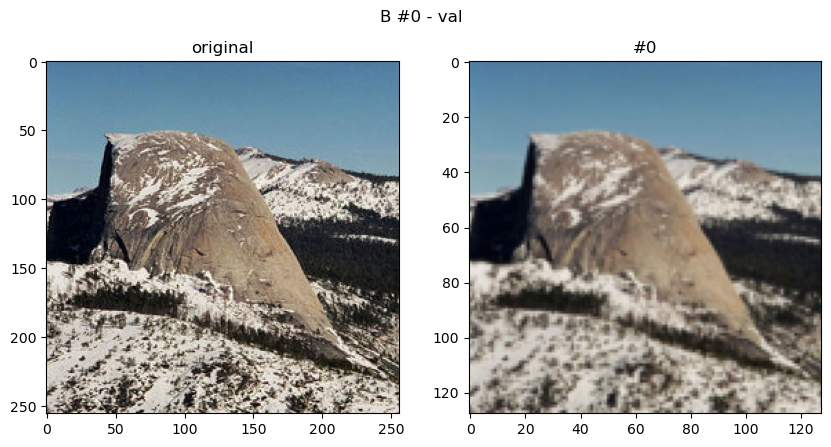

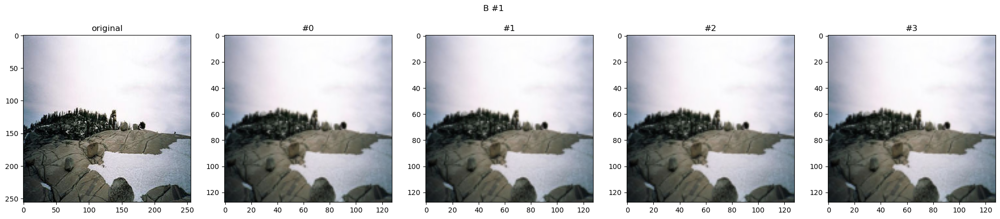

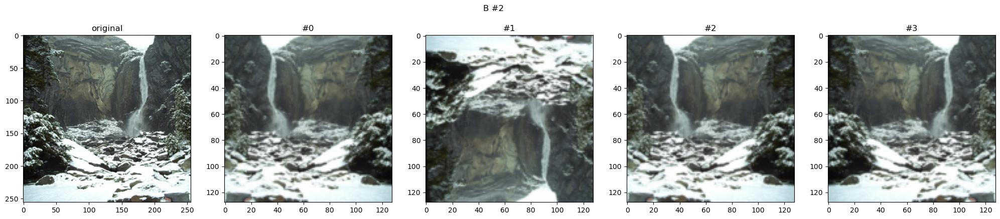

In [6]:
# Функция для получения train и val transform-ов, а так же функции для де-нормализации изображения
def get_transforms(mean, std, p):
    train_transform = tr.Compose([
        tr.ToPILImage(),
        tr.ToTensor(),
        tr.RandomHorizontalFlip(p),
        tr.RandomVerticalFlip(p),
        tr.Normalize(mean=mean, std=std),
        tr.Resize((128,128))
    ])
    
    test_transform = tr.Compose([
        tr.ToPILImage(),
        tr.ToTensor(),
        tr.Normalize(mean=mean, std=std),
        tr.Resize((128,128))
    ])
    
    def de_normalize(img):
        img = img.cpu()
        img_np = img.numpy()
        de_normalized_img = (img_np * std[:, None, None]) + mean[:, None, None]
        de_normalized_img = np.clip(de_normalized_img, 0, 1) # ограничиваем значения пикселей в диапазоне от 0 до 1
        de_normalized_img = np.moveaxis(de_normalized_img, 0, -1) # переставляем количество каналов в конец
        return de_normalized_img
    
    return train_transform, test_transform, de_normalize


# Ваши гиперпараметры
hyperparams = dict(
    p = 0.5
)
# transform-ы для A и B
train_transform_a, val_transform_a, de_normalize_a = get_transforms(channel_mean_a, channel_std_a, **hyperparams)
train_transform_b, val_transform_b, de_normalize_b = get_transforms(channel_mean_b, channel_std_b, **hyperparams)


# Функция для визуализации transform-ов
def show_examples(dataset, transform, de_norm, num_per_image=3, image_index=0, title=""):
    fig, ax = plt.subplots(1, 1 + num_per_image, figsize=(5 * (1 + num_per_image), 5))
    
    image = dataset[image_index]
    
    plt.suptitle(title, y=0.95)

    plt.subplot(1, 1 + num_per_image, 1)
    plt.imshow(image)
    plt.title("original")

    for i in range(num_per_image):
        plt.subplot(1, 1 + num_per_image, i + 2)
        plt.title(f"#{i}")
        plt.imshow(de_norm(transform(image)))
    plt.show()

# Проверка на адекватность
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=0, title="A #0")
show_examples(ds.train_a, val_transform_a, de_normalize_a, num_per_image=1, image_index=0, title="A #0 - val")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=1, title="A #1")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=2, title="A #2")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=0, title="B #0")
show_examples(ds.train_b, val_transform_b, de_normalize_b, num_per_image=1, image_index=0, title="B #0 - val")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=1, title="B #1")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=2, title="B #2")

In [7]:
# Все датасеты с трансформами
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainA"),
        transform=train_transform_a,
    ),
    train_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainB"),
        transform=val_transform_b,
    ),
    test_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "testA"),
        transform=val_transform_a,
    ),
    test_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "testB"),
        transform=val_transform_b,
    ),
)

## 1.3 DataLoader

In [8]:
@dataclass
class DataLoadersClass:
    train_a: DataLoader
    train_b: DataLoader
    test_a: DataLoader
    test_b: DataLoader

batch_size = 1

dataloaders = DataLoadersClass(
    train_a=DataLoader(
        dataset=ds.train_a,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
    ),
    train_b=DataLoader(
        dataset=ds.train_b,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
    ),
    test_a=DataLoader(
        dataset=ds.test_a,
        batch_size=batch_size,
        shuffle=False,
        drop_last=True,
    ),
    test_b=DataLoader(
        dataset=ds.test_b,
        batch_size=batch_size,
        shuffle=False,
        drop_last=True,
    ),
)

# 2. Модель (___6 баллов___)

**GAN (Generative Adversarial Network)** – тип архитектуры нейронной сети, которая может быть использована для генерации новых данных, таких как изображения, музыка или текст. Основная идея GAN заключается в том, что два агента или сети, называемые генератором и дискриминатором, соревнуются друг с другом в игровой среде. Генератор пытается создать новые образцы данных, которые похожи на обучающие данные, а дискриминатор пытается отличить реальные обучающие данные от сгенерированных.

Обе сети обучаются вместе, причем генератор со временем учится создавать более реалистичные образцы, пытаясь перехитрить дискриминатор, который, в свою очередь, учится лучше различать настоящие и поддельные данные.

**CycleGAN**, или **Cycle-Consistent Generative Adversarial Networks** – модификация `GAN`, которая может быть использована для задач перевода изображений с одного языка на другой, когда парные обучающие данные недоступны.

`CycleGAN` имеет ту же базовую концепцию, что и `GAN`, поскольку использует генератор и дискриминатор. Этот алгоритм может переводить изображения между двумя неупорядоченными коллекциями A и B, в обоих направлениях. Это означает, что алгоритм может научиться преобразовывать изображение из A в B, а также изображение из B в A, без какого-либо определенного порядка или сопряжения между изображениями в двух коллекциях.

Цель процесса обучения – разработать генератор $G: A \rightarrow B$, который создает распределение изображений из $G(A)$, достаточно близкое к распределению B, чтобы их нельзя было отличить от реальных изображений с помощью неблагоприятных потерь. Однако, поскольку это отображение может быть сложно ограничить, `CycleGAN` также вводит обратное отображение $F: B \rightarrow A$.

Причина появления $F$ заключается в том, чтобы включить потерю согласованности цикла, чтобы гарантировать, что $F(G(A))$ и $A$ (и наоборот) приблизительно равны. Допустим, у нас есть генератор от лошади к зебре в виде G, и генератор от зебры к лошади в виде $F$. Если мы вставим изображение зебры A, в $G$, а затем снова подадим его в $F$, мы хотим, чтобы оно было таким же идентичным, как и исходное изображение $X$.

Именно поэтому метод получил название `CycleGAN`, так как сеть обучается поддерживать циклическое соответствие между двумя доменами.

###  Архитектура CycleGAN
Пусть `c7s1-k` обозначает слой 7×7 Convolution-InstanceNormReLU с k фильтрами и stride 1. 

`dk` обозначает слой 3×3 Convolution-InstanceNorm-ReLU с k фильтрами и stride 2. 

`Rk` обозначает остаточный блок, содержащий два сверточных слоя 3 × 3 с одинаковым числом фильтров в обоих слоях. 

`uk` обозначает слой 3 × 3 с дробно-решетчатым преобразованием (ConvolutionInstanceNorm-ReLU) с k фильтрами и шагом 1/2.

Генератор состоит из 2 слоев понижающего/кодирующего слоя, затем 6 остаточных блоков для 128 × 128 обучающих изображений и 3 повышающих/декодирующих слоя. Сеть с 6 остаточными блоками может быть записана следующим образом: `c7s1-64`, `d128`, `d256`, `R256`, `R256`, `R256`, `R256`, `R256`, `R256`, `u128`, `u64`, и `c7s1-3`.

<img src='Generator.PNG' width=500, heigth=400>

Пусть `Ck` обозначает слой 4 × 4 Convolution-InstanceNorm-LeakyReLU с k фильтрами и шагом 2.

Архитектура дискриминатора: `C64`-`C128`-`C256`-`C512`. После последнего слоя мы применяем свертку для получения одномерного выходного сигнала. Можно использовать leaky ReLU с наклоном 0.2.

<img src='Discriminator.PNG' width=500, heigth=400>

## 2.0 Любые вспомогательные модули и классы

В классе `ConvolutionalBlock` мы можем инициализировать 2 типа свёрточных блоков. Первый - это блок понижающей дискретизации, а второй - блок повышающей дискретизации. Для апсемплинга используется `ConvTranspose2d`, затем `InstanceNorm2d` и `ReLU`, как описано в архитектуре, упомянутой в [статье](https://arxiv.org/pdf/1703.10593.pdf).

In [9]:
class ConvolutionalBlock(nn.Module):
    def __init__(
        self,
        in_channels: int,
        out_channels: int,
        is_downsampling: bool = True,
        add_activation: bool = True,
        **kwargs
    ):
        super().__init__()
        if is_downsampling:
            self.conv = nn.Sequential(
                # Сверточный слой с отражающим дополнением
                nn.Conv2d(in_channels, out_channels, padding_mode="reflect", **kwargs), 
                # Нормализация по экземпляру
                nn.InstanceNorm2d(out_channels),
                # Если нужно добавить активацию, используется ReLU, иначе - слой Identity
                nn.ReLU(inplace=True) if add_activation else nn.Identity(),
            )
        else:
            self.conv = nn.Sequential(
                # Транспонированная свертка для увеличения размерности
                nn.ConvTranspose2d(in_channels, out_channels, **kwargs),
                # Нормализация по экземпляру
                nn.InstanceNorm2d(out_channels),
                # Если нужно добавить активацию, используется ReLU, иначе - слой Identity
                nn.ReLU(inplace=True) if add_activation else nn.Identity(),
            )

    def forward(self, x):
        return self.conv(x)

Реализуем блок с остаточным соединением:

In [10]:
class ResidualBlock(nn.Module):
    def __init__(self, channels: int):
        super().__init__()
        self.block = nn.Sequential(
            ConvolutionalBlock(channels, channels, add_activation=True, kernel_size=3, padding=1),
            ConvolutionalBlock(channels, channels, add_activation=False, kernel_size=3, padding=1),
        )

    def forward(self, x):
        return x + self.block(x)

## 2.1 Архитектура сети (___3 балла___)

Класс генератора:

In [11]:
class Generator(nn.Module):
    def __init__(
        self, img_channels: int, num_features: int = 64, num_residuals: int = 9
    ):
        super().__init__()
        self.initial_layer = nn.Sequential(
            nn.Conv2d(
                img_channels,
                num_features,
                kernel_size=7,
                stride=1,
                padding=3,
                padding_mode="reflect",
            ),
            nn.ReLU(inplace=True),
        )

        self.downsampling_layers = nn.ModuleList(
            [
                ConvolutionalBlock(
                    num_features, 
                    num_features * 2,
                    is_downsampling=True, 
                    kernel_size=3, 
                    stride=2, 
                    padding=1,
                ),
                ConvolutionalBlock(
                    num_features * 2,
                    num_features * 4,
                    is_downsampling=True,
                    kernel_size=3,
                    stride=2,
                    padding=1,
                ),
            ]
        )

        self.residual_layers = nn.Sequential(
            *[ResidualBlock(num_features * 4) for _ in range(num_residuals)]
        )

        self.upsampling_layers = nn.ModuleList(
            [
                ConvolutionalBlock(
                    num_features * 4,
                    num_features * 2,
                    is_downsampling=False,
                    kernel_size=3,
                    stride=2,
                    padding=1,
                    output_padding=1,
                ),
                ConvolutionalBlock(
                    num_features * 2,
                    num_features * 1,
                    is_downsampling=False,
                    kernel_size=3,
                    stride=2,
                    padding=1,
                    output_padding=1,
                ),
            ]
        )

        self.last_layer = nn.Conv2d(
            num_features * 1,
            img_channels,
            kernel_size=7,
            stride=1,
            padding=3,
            padding_mode="reflect",
        )

    def forward(self, x):
        x = self.initial_layer(x)
        for layer in self.downsampling_layers:
            x = layer(x)
        x = self.residual_layers(x)
        for layer in self.upsampling_layers:
            x = layer(x)
        return torch.tanh(self.last_layer(x))

In [12]:
class ConvInstanceNormLeakyReLUBlock(nn.Module):
    def __init__(self, in_channels: int, out_channels: int, stride: int):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size=4,
                stride=stride,
                padding=1,
                bias=True,
                padding_mode="reflect",
            ),
            nn.InstanceNorm2d(out_channels),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def forward(self, x):
        return self.conv(x)

Класс дискриминатора:

In [13]:
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, features=[64, 128, 256, 512]):
        super().__init__()
        self.initial_layer = nn.Sequential(
            nn.Conv2d(
                in_channels,
                features[0],
                kernel_size=4,
                stride=2,
                padding=1,
                padding_mode="reflect",
            ),
            nn.LeakyReLU(0.2, inplace=True),
        )

        layers = []
        in_channels = features[0]
        for feature in features[1:]:
            layers.append(
                ConvInstanceNormLeakyReLUBlock(
                    in_channels, 
                    feature, 
                    stride=1 if feature == features[-1] else 2,
                )
            )
            in_channels = feature

        layers.append(
            nn.Conv2d(
                in_channels,
                1,
                kernel_size=4,
                stride=1,
                padding=1,
                padding_mode="reflect",
            )
        )
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        x = self.initial_layer(x)
        return torch.sigmoid(self.model(x))

In [14]:
class CycleGAN(nn.Module):
    def __init__(self, img_channels, device):
        super().__init__()
        self.device = device
        # Инициализация генераторов и дискриминаторов
        self.G_AB = Generator(img_channels).to(device)
        self.G_BA = Generator(img_channels).to(device)
        self.D_A = Discriminator().to(device)
        self.D_B = Discriminator().to(device)

    def forward(self, real_A, real_B):
        fake_B = self.G_AB(real_A)
        cycled_A = self.G_BA(fake_B)
        fake_A = self.G_BA(real_B)
        cycled_B = self.G_AB(fake_A)

        return fake_A, fake_B, cycled_A, cycled_B

## 2.2 Loss (___3 балла___)

Цикличная согласованность `CycleConsistencyLoss` обеспечивает, что после перевода изображения из домена $A$ в домен $B$ и обратно, мы получим изображение, близкое к исходному. Это помогает предотвратить ситуацию, когда генераторы могут изменять изображения нерелевантным образом, сохраняя при этом высокую оценку от дискриминаторов.

$$ \mathbf{L}_{\text{cyc}} \big( G_{A \rightarrow B}, G_{B \rightarrow A} \big) = \mathbb{E}_{a \sim A} \bigg( \Big\| G_{B \rightarrow A} \big( G_{A \rightarrow B} ( a ) \big) - a \Big\|_1 \bigg) + \mathbb{E}_{b \sim B} \bigg( \Big\| G_{A \rightarrow B} \big( G_{B \rightarrow A} ( b ) \big) - b \Big\|_1 \bigg) \longrightarrow \min_{G}$$

In [15]:
class CycleConsistencyLoss(nn.Module):
    """
    Функция ошибки, проверяющая что после двойного перехода через генераторы изображение не изменилось
    """
    def __init__(self):
        super(CycleConsistencyLoss, self).__init__()
    
    def forward(self, x, x_rec):
        # Принимает на вход оригинальное изображение и изображение после двойного перехода
        return torch.mean(torch.abs(x - x_rec))

`AdversarialLoss` заставляет генераторы создавать изображения, которые не могут быть отличены от реальных дискриминаторами. Другими словами, он помогает генераторам улучшать качество генерируемых изображений, делая их более реалистичными.

$$ \mathbf{L}_{\text{GAN}} \big( G_{A \rightarrow B}, D_{B} \big) = \mathbb{E}_{b \sim B} \log D_{B} (b) + \mathbb{E}_{a \sim A} \log \Big( 1 - D_{B} \big( G_{A \rightarrow B} (a) \big) \Big) \longrightarrow \min_{G} \max_{D}$$

In [16]:
class AdversarialLossCE(nn.Module):
    """
    Стандартная функция ошибки для minmax игры GAN-ов
    """
    def __init__(self):
        super(AdversarialLossCE, self).__init__()
    
    def forward(self, real_pred, fake_pred=None):
        if fake_pred is not None:
            # Потери дискриминатора
            dis_real_loss = torch.mean(torch.log(real_pred))  # логарифм вероятностей реальных образцов быть настоящими
            dis_fake_loss = torch.mean(torch.log(1 - fake_pred))  # логарифм вероятностей фальшивых образцов быть фальшивыми
            dis_loss = - (dis_real_loss + dis_fake_loss) / 2 # минус потому что мы максимизируем D
            return dis_loss
        else:
            # Потери генератора
            gen_loss = -torch.mean(torch.log(1 - real_pred))  # Генератор стремится минимизировать log(1 - D(G(z)))
            return gen_loss

$$ \mathbb{E}_{b \sim B} \big( D_{B} (b) - 1 \big)^2 + \mathbb{E}_{a \sim A} \Big( D_{B} \big( G_{A \rightarrow B} (a) \big) \Big)^2 \longrightarrow \min_{D} $$
$$ \mathbb{E}_{a \sim A} \Big( D_{B} \big( G_{A \rightarrow B} (a) \big) - 1 \Big)^2 \longrightarrow \min_{G} $$

In [17]:
class AdversarialLossMSE(nn.Module):
    """
    Можно переписать не через CE, а через MSE loss на одном предсказании, помогает со стабильностью
    """
    def __init__(self):
        super(AdversarialLossMSE, self).__init__()
        self.mse_loss = nn.MSELoss()
    
    def forward(self, real_pred, fake_pred=None):
        # Принимает на вход D_{A}(a) - real_pred и D_{A}(G(b)) - fake_pred или наоборот
        # Может принимать только один аргумент для удобности использования в случае
        #  обучения или генератора, или дискриминатора
        if fake_pred is not None:
            # Потери для дискриминатора
            dis_real_loss = self.mse_loss(real_pred, torch.ones_like(real_pred))
            dis_fake_loss = self.mse_loss(fake_pred, torch.zeros_like(fake_pred))
            dis_loss = (dis_real_loss + dis_fake_loss) / 2
            return dis_loss
        else:
            # Потери для генератора
            gen_loss = self.mse_loss(real_pred, torch.ones_like(real_pred))
            return gen_loss

$$ \mathbf{L} \big( G_{A \rightarrow B}, G_{B \rightarrow A}, D_{A}, D_{B} \big) = \mathbf{L}_{\text{GAN}} \big( G_{A \rightarrow B}, D_{B} \big) + \mathbf{L}_{\text{GAN}} \big( G_{B \rightarrow A}, D_{A} \big) + \lambda \cdot \mathbf{L}_{\text{cyc}} \big( G_{A \rightarrow B}, G_{B \rightarrow A} \big) \longrightarrow \min_{G} \max_{D}$$

In [18]:
class FullDiscriminatorLoss(nn.Module):
    """
    Полная ошибка для дискриминатора
    """
    def __init__(self, is_mse=True):
        super(FullDiscriminatorLoss, self).__init__()
        if is_mse:
            self.adversarial_loss_func = AdversarialLossMSE()
        else:
            self.adversarial_loss_func = AdversarialLossCE()
    
    def forward(self, real_pred, fake_pred=None):
        loss = self.adversarial_loss_func.forward(real_pred, fake_pred)
        return loss

In [19]:
class FullGeneratorLoss(nn.Module):
    """
    Полная ошибка для генератора
    """
    def __init__(self, lambda_value=10., is_mse=True):
        super(FullGeneratorLoss, self).__init__()
        if is_mse:
            self.adversarial_loss_func = AdversarialLossMSE()
        else:
            self.adversarial_loss_func = AdversarialLossCE()
        self.cycle_consistency_loss_func = CycleConsistencyLoss()
        self.lambda_value = lambda_value

    def forward(self, real_pred, fake_pred, rec):
        loss_GAN = self.adversarial_loss_func.forward(real_pred)
        loss_cyc = self.cycle_consistency_loss_func.forward(real_pred, rec)
        return loss_GAN + self.lambda_value * loss_cyc

# 3. Подготовка обучения (__2 балла__)

## 3.1 Шаг обучения дискриминатора

In [20]:
def train_discriminators(model, opt_d, loader_a, loader_b, criterion_d):
    model.train()
    losses_tr = []
    
    iter_a = iter(loader_a)
    iter_b = iter(loader_b)
    batches_per_epoch = min(len(iter_a), len(iter_b))
    
    for _ in trange(batches_per_epoch):
        imgs_a = next(iter_a).to(device)
        imgs_b = next(iter_b).to(device)
        
        opt_d.zero_grad()
        
        # Генерация фейковых изображений
        fake_A = model.G_BA(imgs_b).detach()
        fake_B = model.G_AB(imgs_a).detach()
        
        # Вычисление ошибки для дискриминаторов
        real_pred_A = model.D_A(imgs_a)
        fake_pred_A = model.D_A(fake_A)
        real_pred_B = model.D_B(imgs_b)
        fake_pred_B = model.D_B(fake_B)
        
        loss_A = criterion_d(real_pred_A, fake_pred_A)
        loss_B = criterion_d(real_pred_B, fake_pred_B)
        loss = (loss_A + loss_B) / 2
        
        loss.backward()
        opt_d.step()
        losses_tr.append(loss.item())
    
    return model, opt_d, np.mean(losses_tr)

## 3.2 Шаг обучения генератора

In [21]:
def train_generators(model, opt_g, loader_a, loader_b, criterion_g):
    model.train()
    total_loss = 0.0
    iter_a = iter(loader_a)
    iter_b = iter(loader_b)
    batches_per_epoch = min(len(loader_a), len(loader_b))

    for i in trange(batches_per_epoch):
        imgs_a = next(iter_a).to(model.device)
        imgs_b = next(iter_b).to(model.device)

        opt_g.zero_grad()

        # Генерация и восстановление изображений
        fake_A = model.G_BA(imgs_b)
        fake_B = model.G_AB(imgs_a)
        rec_A = model.G_BA(fake_B)
        rec_B = model.G_AB(fake_A)

        # Вычисление потерь
        loss_A = criterion_g(imgs_a, fake_A, rec_A)
        loss_B = criterion_g(imgs_b, fake_B, rec_B)

        loss = (loss_A + loss_B) / 2
        loss.backward()
        opt_g.step()
        total_loss += loss.item()

    average_loss = total_loss / batches_per_epoch
    return model, opt_g, average_loss

## 3.3 Шаг валидации

In [22]:
from collections import defaultdict

def val(model, loader_a, loader_b, criterion_d, criterion_g):
    model.eval()
    val_data = defaultdict(list)

    with torch.no_grad():
        iter_a = iter(loader_a)
        iter_b = iter(loader_b)
        batches_per_epoch = min(len(loader_a), len(loader_b))

        for _ in trange(batches_per_epoch):
            imgs_a = next(iter_a).to(model.device)
            imgs_b = next(iter_b).to(model.device)

            # Генерация фейковых изображений
            fake_A = model.G_BA(imgs_b)
            fake_B = model.G_AB(imgs_a)
            
            # Восстановление изображений
            rec_A = model.G_BA(fake_B)
            rec_B = model.G_AB(fake_A)

            # Вычисление ошибки для дискриминаторов и генераторов
            real_pred_A = model.D_A(imgs_a)
            fake_pred_A = model.D_A(fake_A)
            real_pred_B = model.D_B(imgs_b)
            fake_pred_B = model.D_B(fake_B)

            loss_d_A = criterion_d(real_pred_A, fake_pred_A)
            loss_d_B = criterion_d(real_pred_B, fake_pred_B)
            loss_g_A = criterion_g(imgs_a, fake_A, rec_A)
            loss_g_B = criterion_g(imgs_b, fake_B, rec_B)

            loss_d = (loss_d_A + loss_d_B) / 2
            loss_g = (loss_g_A + loss_g_B) / 2

            # Добавление потерь в val_data
            val_data["loss D"].append(loss_d.item())
            val_data["loss G"].append(loss_g.item())

            # Логирование предсказаний (исправленное)
            real_pred_A = torch.sigmoid(real_pred_A).cpu().detach().numpy()
            real_pred_B = torch.sigmoid(real_pred_B).cpu().detach().numpy()
            fake_pred_A = torch.sigmoid(fake_pred_A).cpu().detach().numpy()
            fake_pred_B = torch.sigmoid(fake_pred_B).cpu().detach().numpy()

            val_data["real pred A"].extend(real_pred_A.tolist())
            val_data["real pred B"].extend(real_pred_B.tolist())
            val_data["fake pred A"].extend(fake_pred_A.tolist())
            val_data["fake pred B"].extend(fake_pred_B.tolist())

        # Вычисление средних значений потерь
        val_data["loss D"] = np.mean(val_data["loss D"])
        val_data["loss G"] = np.mean(val_data["loss G"])

    return val_data

## 3.4 Визуализация сгенерированного

In [23]:
def draw_imgs(model, num_images, loader_a, loader_b, de_norm_a, de_norm_b):
    model.eval()
    with torch.no_grad():
        imgs_a = next(iter(loader_a))[:num_images].to(device)
        imgs_b = next(iter(loader_b))[:num_images].to(device)
        
        fake_a = model.G_BA(imgs_b)
        fake_b = model.G_AB(imgs_a)
        rec_a = model.G_BA(fake_b)
        rec_b = model.G_AB(fake_a)
        
        # Draw num_images examples for A
        max_index = min(imgs_a.size(0), imgs_b.size(0), num_images)
        fig, ax = plt.subplots(max_index, 3, figsize=(25, 15))
        plt.suptitle("Images from A", y=0.92)
        
        for ind in range(max_index):
            plt.subplot(num_images, 3, ind * 3 + 1)
            plt.title("Original from A")
            plt.imshow(de_norm_a(imgs_a[ind]))
            plt.xticks([])
            plt.yticks([])
            
            plt.subplot(num_images, 3, ind * 3 + 2)
            plt.title("Translated to B")
            plt.imshow(de_norm_b(fake_b[ind]))
            plt.xticks([])
            plt.yticks([])
            
            plt.subplot(num_images, 3, ind * 3 + 3)
            plt.title("Reconstructed A")
            plt.imshow(de_norm_a(rec_a[ind]))
            plt.xticks([])
            plt.yticks([])
        
        # Draw num_images examples for B
        fig, ax = plt.subplots(max_index, 3, figsize=(25, 15))
        plt.suptitle("Images from B", y=0.92)
        
        for ind in range(max_index):
            plt.subplot(num_images, 3, ind * 3 + 1)
            plt.title("Original from B")
            plt.imshow(de_norm_b(imgs_b[ind]))
            plt.xticks([])
            plt.yticks([])
            
            plt.subplot(num_images, 3, ind * 3 + 2)
            plt.title("Translated to A")
            plt.imshow(de_norm_a(fake_a[ind]))
            plt.xticks([])
            plt.yticks([])
            
            plt.subplot(num_images, 3, ind * 3 + 3)
            plt.title("Reconstructed B")
            plt.imshow(de_norm_b(rec_b[ind]))
            plt.xticks([])
            plt.yticks([])
    
        plt.show()

## 3.5 Цикл обучения

In [24]:
from IPython.display import clear_output
import warnings

def get_model_name(chkp_folder, model_name=None):
    # Выбираем имя чекпоинта для сохранения
    if model_name is None:
        if os.path.exists(chkp_folder):
            num_starts = len(os.listdir(chkp_folder)) + 1
        else:
            num_starts = 1
        model_name = f'model#{num_starts}'
    else:
        if "#" not in model_name:
            model_name += "#0"
    changed = False
    while os.path.exists(os.path.join(chkp_folder, model_name + '.pt')):
        model_name, ind = model_name.split("#")
        model_name += f"#{int(ind) + 1}"
        changed=True
    if changed:
        warnings.warn(f"Selected model_name was used already! To avoid possible overwrite - model_name changed to {model_name}")
    return model_name


def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']


def learning_loop(
    model,
    optimizer_g,
    g_iters_per_epoch,
    optimizer_d,
    d_iters_per_epoch,
    train_loader_a,
    train_loader_b,
    val_loader_a,
    val_loader_b,
    criterion_d,
    criterion_g,
    de_norm_a,
    de_norm_b,
    scheduler_d=None,
    scheduler_g=None,
    min_lr=None,
    epochs=10,
    val_every=1,
    draw_every=1,
    model_name=None,
    chkp_folder="./chkps",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
):
    model_name = get_model_name(chkp_folder, model_name)
    
    if plots is None:
        plots = {
            'train G': [],
            'train D': [],
            'val D': [],
            'val G': [],
            "lr G": [],
            "lr D": [],
            "hist real A": [],
            "hist gen A": [],
            "hist real B": [],
            "hist gen B": [],
        }

    for epoch in np.arange(1, epochs+1) + starting_epoch:
        print(f'#{epoch}/{epochs}:')

        plots['lr G'].append(get_lr(optimizer_g))
        plots['lr D'].append(get_lr(optimizer_d))
        
        # train discriminators
        print(f"train discriminators ({d_iters_per_epoch} times)")
        loss_d = []
        for _ in range(d_iters_per_epoch):
            model, optimizer_d, loss = train_discriminators(model, optimizer_d, train_loader_a, train_loader_b, criterion_d)
            loss_d.append(loss)
        plots['train D'].extend(loss_d)
        
        # train generators
        print(f"train generators ({g_iters_per_epoch} times)")
        loss_g = []
        for _ in range(g_iters_per_epoch):
            model, optimizer_g, loss = train_generators(model, optimizer_g, train_loader_a, train_loader_b, criterion_g)
            loss_g.append(loss)
        plots['train G'].extend(loss_g)

        if not (epoch % val_every):
            print("validate")
            val_data = val(model, val_loader_a, val_loader_b, criterion_d, criterion_g)
            plots['val D'].append(val_data["loss D"])
            plots['val G'].append(val_data["loss G"])
            plots['hist real A'].append(val_data["real pred A"])
            plots['hist gen A'].append(val_data["fake pred A"])
            plots['hist real B'].append(val_data["real pred B"])
            plots['hist gen B'].append(val_data["fake pred B"])
            
            # Сохраняем модель
            if not os.path.exists(chkp_folder):
                os.makedirs(chkp_folder)
            torch.save(
                {
                    'epoch': epoch,
                    'model_state_dict': model.state_dict(),
                    'optimizer_d_state_dict': optimizer_d.state_dict(),
                    'optimizer_g_state_dict': optimizer_g.state_dict(),
                    'scheduler_d_state_dict': scheduler_d.state_dict(),
                    'scheduler_g_state_dict': scheduler_g.state_dict(),
                    'plots': plots,
                },
                os.path.join(chkp_folder, model_name + '.pt'),
            )
            
            # Шедулинг
            if scheduler_d:
                try:
                    scheduler_d.step()
                except:
                    scheduler_d.step(loss_d)
            if scheduler_g:
                try:
                    scheduler_g.step()
                except:
                    scheduler_g.step(loss_g)

        if not (epoch % draw_every):
            clear_output(True)
            
            hh = 2
            ww = 2
            plt_ind = 1
            fig, ax = plt.subplots(hh, ww, figsize=(25, 12))
            fig.suptitle(f'#{epoch}/{epochs}:')

            plt.subplot(hh, ww, plt_ind)
            plt.title('discriminators losses')
            d_plot_step = 1. / d_iters_per_epoch
            plt.plot(np.arange(d_plot_step, epoch + d_plot_step, d_plot_step), plots['train D'], 'r.-', label='train', alpha=0.7)
            plt.plot(np.arange(1, epoch + 1), plots['val D'], 'g.-', label='val', alpha=0.7)
            plt.grid()
            plt.legend()
            plt_ind += 1
            
            plt.subplot(hh, ww, plt_ind)
            plt.title('generators losses')
            g_plot_step = 1. / g_iters_per_epoch
            plt.plot(np.arange(g_plot_step, epoch + g_plot_step, g_plot_step), plots['train G'], 'r.-', label='train', alpha=0.7)
            plt.plot(np.arange(1, epoch + 1), plots['val G'], 'g.-', label='val', alpha=0.7)
            plt.grid()
            plt.legend()
            plt_ind += 1
            
            # plt.subplot(hh, ww, plt_ind)
            # plt.title('learning rates')
            # plt.plot(plots["lr D"], 'b.-', label='lr discriminator', alpha=0.7)
            # plt.plot(plots["lr G"], 'm.-', label='lr generator', alpha=0.7)
            # plt.legend()
            # plt_ind += 1
            
            real_A_data_flat = np.array(plots["hist real A"][-1]).flatten()
            gen_A_data_flat = np.array(plots["hist gen A"][-1]).flatten()
            real_B_data_flat = np.array(plots["hist real B"][-1]).flatten()
            gen_B_data_flat = np.array(plots["hist gen B"][-1]).flatten()
            
            plt.subplot(hh, ww, plt_ind)
            plt.title("Discriminator A predictions")
            plt.hist(real_A_data_flat, bins=50, density=True, label="real", color="green", alpha=0.7)
            plt.hist(gen_A_data_flat, bins=50, density=True, label="generated", color="red", alpha=0.7)
            plt.xlim((-0.05, 1.05))
            plt.xticks(ticks=np.arange(0, 1.05, 0.1))
            plt.legend()
            plt_ind += 1
            
            plt.subplot(hh, ww, plt_ind)
            plt.title("Discriminator B predictions")
            plt.hist(real_B_data_flat, bins=50, density=True, label="real", color="green", alpha=0.7)
            plt.hist(gen_B_data_flat, bins=50, density=True, label="generated", color="red", alpha=0.7)
            plt.xlim((-0.05, 1.05))
            plt.xticks(ticks=np.arange(0, 1.05, 0.1))
            plt.legend()
            plt_ind += 1
            
            plt.show()
            
            draw_imgs(model, images_per_validation, val_loader_a, val_loader_b, de_norm_a, de_norm_b)
                
        
        if min_lr and get_lr(optimizer_d) <= min_lr:
            print(f'Learning process ended with early stop for discriminator after epoch {epoch}')
            break
        
        if min_lr and get_lr(optimizer_g) <= min_lr:
            print(f'Learning process ended with early stop for generator after epoch {epoch}')
            break
    
    return model, optimizer_d, optimizer_g, plots

# 4. Обучение (___2 балла___)

## 4.1 Инициализация модели и оптимайзера

In [25]:
from collections import defaultdict
from termcolor import colored


def beautiful_int(i):
    i = str(i)
    return ".".join(reversed([i[max(j, 0):j+3] for j in range(len(i) - 3, -3, -3)]))


# Подсчёт числа параметров в нашей модели
def model_num_params(model, verbose_all=True, verbose_only_learnable=False):
    sum_params = 0
    sum_learnable_params = 0
    submodules = defaultdict(lambda : [0, 0])
    for name, param in model.named_parameters():
        num_params = param.numel()
        if verbose_all or (verbose_only_learnable and param.requires_grad):
            print(
                colored(
                    '{: <65} ~  {: <9} params ~ grad: {}'.format(
                        name,
                        beautiful_int(num_params),
                        param.requires_grad,
                    ),
                    {True: "green", False: "red"}[param.requires_grad],
                )
            )
        sum_params += num_params
        sm = name.split(".")[0]
        submodules[sm][0] += num_params
        if param.requires_grad:
            sum_learnable_params += num_params
            submodules[sm][1] += num_params
    print(
        f'\nIn total:\n  - {beautiful_int(sum_params)} params\n  - {beautiful_int(sum_learnable_params)} learnable params'
    )
    
    for sm, v in submodules.items():
        print(
            f"\n . {sm}:\n .   - {beautiful_int(submodules[sm][0])} params\n .   - {beautiful_int(submodules[sm][1])} learnable params"
        )
    return sum_params, sum_learnable_params

In [26]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

def create_model_and_optimizer(model_class, model_params, lr=1e-3, betas=(0.5, 0.999), device=device):
    model = model_class(**model_params)
    model = model.to(device)
    
    optimizer_d = torch.optim.Adam(
        model.parameters(),
        lr,
        betas,
    )
    optimizer_g = torch.optim.Adam(
        model.parameters(),
        lr,
        betas,
    )
    return model, optimizer_d, optimizer_g

## 4.2 Фактическое обучение

In [27]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

results = []

model, optimizer_d, optimizer_g = create_model_and_optimizer(
    model_class = CycleGAN,
    model_params = {'img_channels': 3, 'device': device},
    lr = 1e-3,
    device = device,
)


scheduler_d = ExponentialLR(optimizer_d, gamma=0.9)
scheduler_g = ExponentialLR(optimizer_g, gamma=0.9)

criterion_d = FullDiscriminatorLoss()
criterion_g = FullGeneratorLoss()

sum_params, sum_learnable_params = model_num_params(model)

G_AB.initial_layer.0.weight                                       ~  9.408     params ~ grad: True
G_AB.initial_layer.0.bias                                         ~  64        params ~ grad: True
G_AB.downsampling_layers.0.conv.0.weight                          ~  73.728    params ~ grad: True
G_AB.downsampling_layers.0.conv.0.bias                            ~  128       params ~ grad: True
G_AB.downsampling_layers.1.conv.0.weight                          ~  294.912   params ~ grad: True
G_AB.downsampling_layers.1.conv.0.bias                            ~  256       params ~ grad: True
G_AB.residual_layers.0.block.0.conv.0.weight                      ~  589.824   params ~ grad: True
G_AB.residual_layers.0.block.0.conv.0.bias                        ~  256       params ~ grad: True
G_AB.residual_layers.0.block.1.conv.0.weight                      ~  589.824   params ~ grad: True
G_AB.residual_layers.0.block.1.conv.0.bias                        ~  256       params ~ grad: True
G_AB.resid

In [28]:
model

CycleGAN(
  (G_AB): Generator(
    (initial_layer): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), padding_mode=reflect)
      (1): ReLU(inplace=True)
    )
    (downsampling_layers): ModuleList(
      (0): ConvolutionalBlock(
        (conv): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
          (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (1): ConvolutionalBlock(
        (conv): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
          (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
    )
    (residual_layers): Sequential(
      (0): ResidualBlock(
        (block): Sequential(
          (0): ConvolutionalBlock(

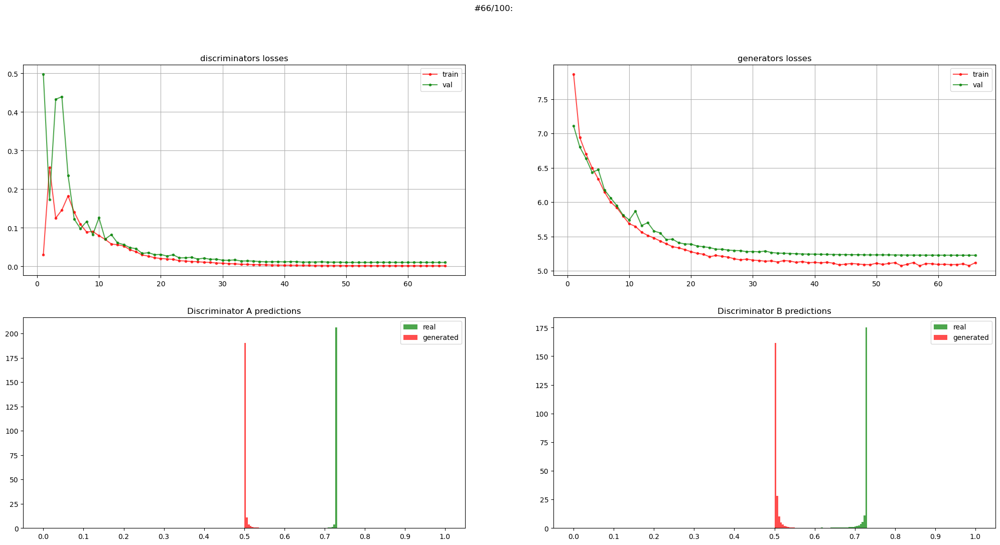

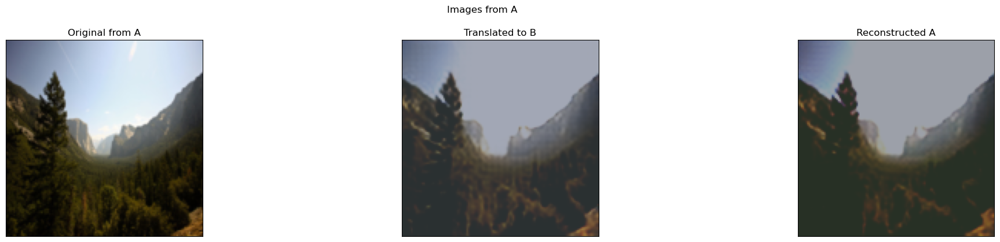

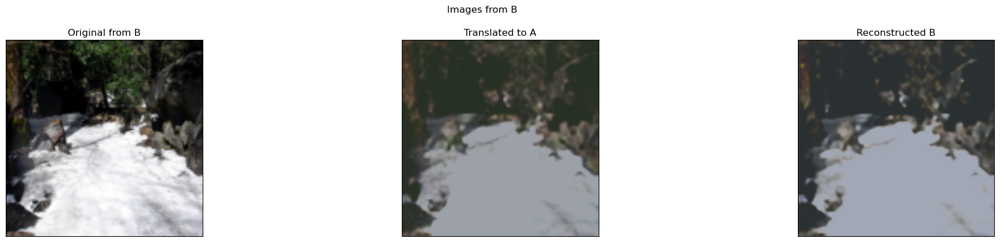

Learning process ended with early stop for discriminator after epoch 66
CPU times: total: 7h 41min 5s
Wall time: 1h 20min 42s


In [29]:
%%time
model, optimizer_d, optimizer_g, plots = learning_loop(
    model = model,
    optimizer_g = optimizer_g,
    g_iters_per_epoch = 1,
    optimizer_d = optimizer_d,
    d_iters_per_epoch = 1,
    train_loader_a = dataloaders.train_a,
    train_loader_b = dataloaders.train_b,
    val_loader_a = dataloaders.test_a,
    val_loader_b = dataloaders.test_b,
    criterion_d = criterion_d,
    criterion_g = criterion_g,
    scheduler_g = scheduler_g,
    scheduler_d = scheduler_d,
    de_norm_a = de_normalize_a,
    de_norm_b = de_normalize_b,
    epochs = 100,
    min_lr = 1e-6,
    val_every = 1,
    draw_every = 1,
    chkp_folder = "./chkp",
    model_name = "cycle_gan",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
)

Посмотрим, как обученная модель `CycleGan` преобразовывает лето в зиму:

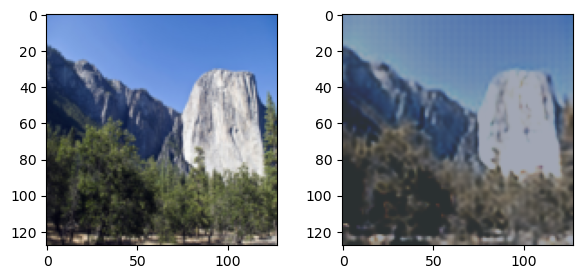

In [50]:
img_a = ds.test_a[1].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_AB(img_a)[0].cpu().detach()))

plt.show()

Видим, что она действительно убрала озеленение с листьев деревьев

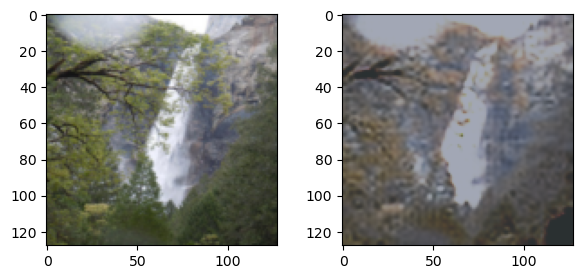

In [51]:
img_a = ds.test_a[5].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_AB(img_a)[0].cpu().detach()))

plt.show()

Здесь модель скорее сделала позднюю осень и раскрасила листья в оранжево-желтые оттенки

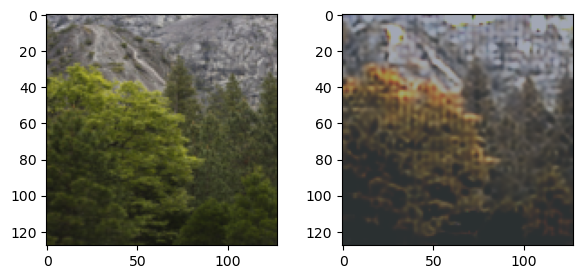

In [52]:
img_a = ds.test_a[10].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_AB(img_a)[0].cpu().detach()))

plt.show()

На данном примере в горах появился снег, а листья окрасились в золотые осенние цвета

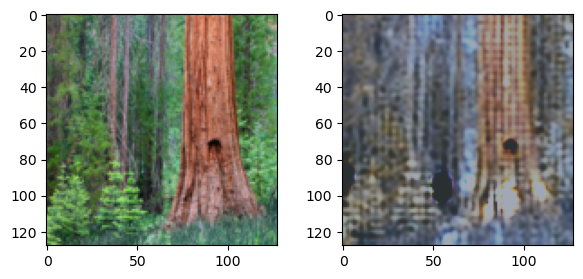

In [54]:
img_a = ds.test_a[27].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_AB(img_a)[0].cpu().detach()))

plt.show()

Данный пример лучше всего демонстрирует, как трава превратилась в снег в лесу

Посмотрим, ради интереса, как работает модель в обратном направлении, то есть превращает зиму в лето:

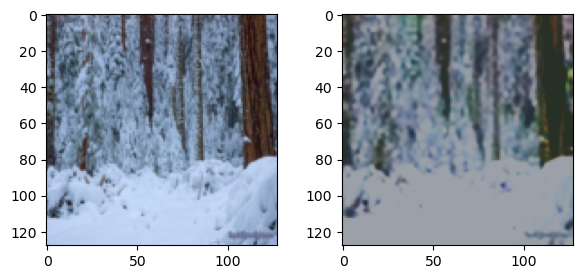

In [206]:
img_ind = 15
img_b = ds.test_b[img_ind].to(device).unsqueeze(0)
fake_a = model.G_BA(img_b)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_b(img_b[0].cpu().detach()))

plt.subplot(122)
plt.imshow(de_normalize_a(fake_a[0].cpu().detach())) 

plt.show()

Видим, что сильных изменений на картинке нет. Всё также лежит снег, но на стволах деревьев появилось немного озеленение. 
Однако, если сравнивать результаты с [оригинальной статьей](https://arxiv.org/pdf/1703.10593.pdf) 
![](WS.PNG)
видим, что они почти идентичны :)

Перед обучением модели для следующей задачи, очистим кэш на видеокарте:

In [232]:
torch.cuda.empty_cache()

# 5. Свои данные (___3 балла + бонусы___)

В этой части нужно сделать следующее:

* Собрать свой один или пару небольших датасетов (хотя бы 100 примеров, но чем больше тем лучше у вас будет качество финальной модели) - формально ограничений нет, но давайте без чего-то неадекватного или за рамками
* Обучить модель CycleGAN между вашим датасетом и каким-то ещё (либо так же вашим, либо любым существующим - полностью на вашу фантазию)
* Для сдачи задания - требуется
    * приложить ссылку на заархивированный датасет, на котором вы обучались
    * в ноутбуке сделать наглядную визуализацию данных из A и B (желательно с текстовым описанием вашей задумки)
    * в ноутбуке иметь код обучения вашей модели
    * в ноутбуке иметь визуальные результаты работы вашей модели (A в B и B в A - хотя бы по 5 примеров на каждый)
* __Задание предполагает возможность получения дополнительных баллов сверх стоимости домашки за интересные и качественные датасеты, а так же модели высокого качества__

___Удачи!___

Будем решать задачу `human2anime` в рамках применения `CycleGAN` состоящего в преобразовании фотографий лиц людей в стилизованные изображения аниме. Это направление визуальной трансформации исследует, как можно адаптировать реалистичные черты человеческого лица к выразительным и стилизованным чертам аниме, которые часто включают преувеличенные эмоции, уникальные пропорции (например, большие глаза) и яркую цветовую палитру:

![](my_example.PNG)

Заархивированный кастомный датасет можно скачать по [ссылке](https://drive.google.com/file/d/1qA3uR5LdZj-Iv2b94-rDq7REW69aHq7A/view?usp=sharing)

Посмотрим на датасет и что он из себя представляет:

Provided splits: ['testA', 'testB', 'trainA', 'trainB']
Split 'testA' of dataset human2anime' --> size: 255


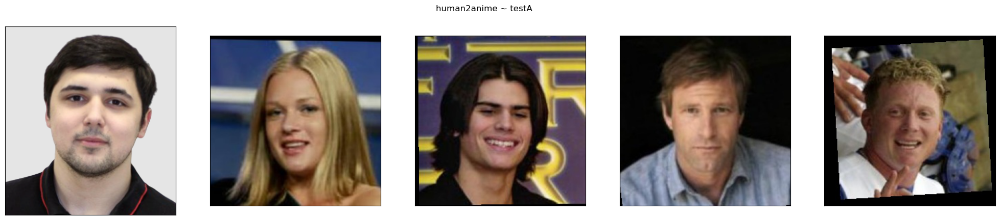

Split 'testB' of dataset human2anime' --> size: 770


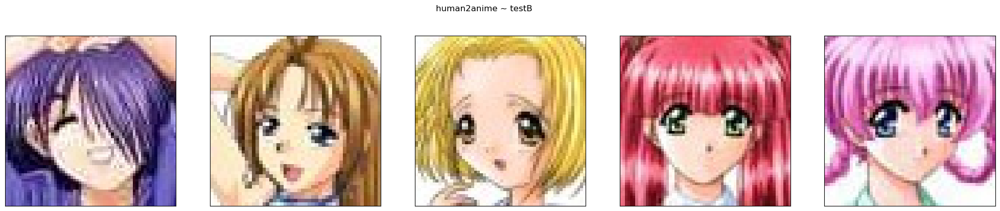

Split 'trainA' of dataset human2anime' --> size: 1899


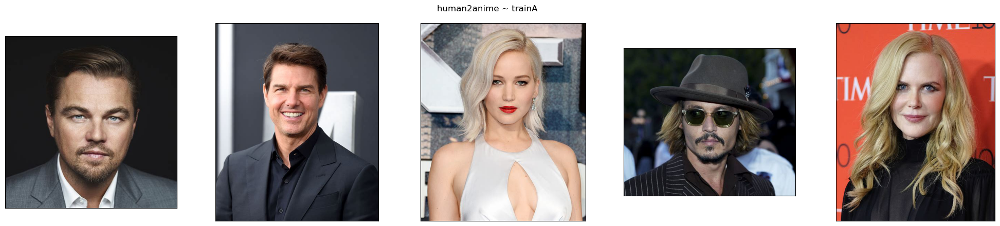

Split 'trainB' of dataset human2anime' --> size: 1406


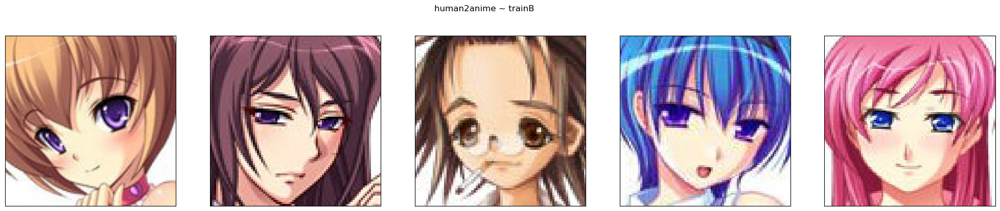


----------------------------



In [228]:
target_folder = r"C:\Users\Natusa\Desktop\human2anime"

# Meta + Отрисовка
print(f"Provided splits: {os.listdir(target_folder)}")
dataset = datasets.ImageFolder(target_folder)

inds_to_show = {i: [] for i, _ in enumerate(dataset.classes)}
classes_full = 0
for dataset_ind in range(len(dataset)):
    _, split_ind = dataset[dataset_ind]
    if len(inds_to_show[split_ind]) == num_images_per_split:
        continue
    inds_to_show[split_ind].append(dataset_ind)
    if len(inds_to_show[split_ind]) == num_images_per_split:
        classes_full += 1
    if classes_full == len(dataset.classes):
        break

for split_name in sorted(dataset.classes):
    split_ind = dataset.class_to_idx[split_name]
    print(f"Split '{split_name}' of dataset human2anime'", end="")
    split_folder = os.path.join(target_folder, split_name)
    print(f" --> size: {len(os.listdir(split_folder))}")

    plt.subplots(1, num_images_per_split, figsize=(5 * num_images_per_split, 5))
    plt.suptitle(f"human2anime ~ {split_name}", y=0.95)
    for i, dataset_ind in enumerate(inds_to_show[split_ind]):
        plt.subplot(1, num_images_per_split, i + 1)
        plt.imshow(dataset[dataset_ind][0])
        plt.xticks([])
        plt.yticks([])
    plt.show()
    
print("\n----------------------------\n")

In [233]:
@dataclass
class DatasetsClass:
    train_a: ImageDatasetNoLabel
    train_b: ImageDatasetNoLabel
    test_a: ImageDatasetNoLabel
    test_b: ImageDatasetNoLabel


# Все датасеты без трансформов - чтобы посчитать статистики
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(os.path.join(target_folder, "trainA")),
    train_b=ImageDatasetNoLabel(os.path.join(target_folder, "trainB")),
    test_a=ImageDatasetNoLabel(os.path.join(target_folder, "testA")),
    test_b=ImageDatasetNoLabel(os.path.join(target_folder, "testB")),
)

In [234]:
# Поканальное среднее и отклонение для A
channel_mean_a, channel_std_a = get_channel_statistics(ds.train_a)
print(channel_mean_a, channel_std_a)

# Поканальное среднее и отклонение для B
channel_mean_b, channel_std_b = get_channel_statistics(ds.train_b)
print(channel_mean_b, channel_std_b)

  0%|          | 0/1899 [00:00<?, ?it/s]

[0.4822514  0.41647078 0.39185683] [0.27799032 0.25247355 0.24705456]


  0%|          | 0/1406 [00:00<?, ?it/s]

[0.68343664 0.59047558 0.57710049] [0.25996322 0.27214917 0.24676411]


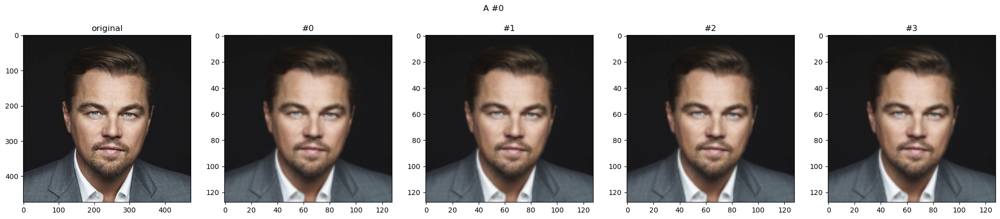

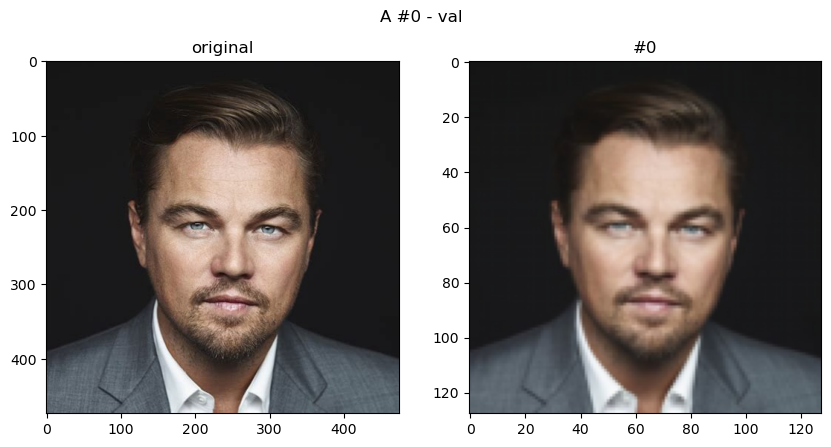

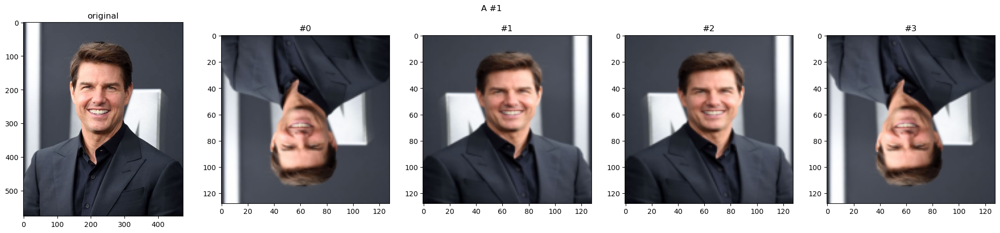

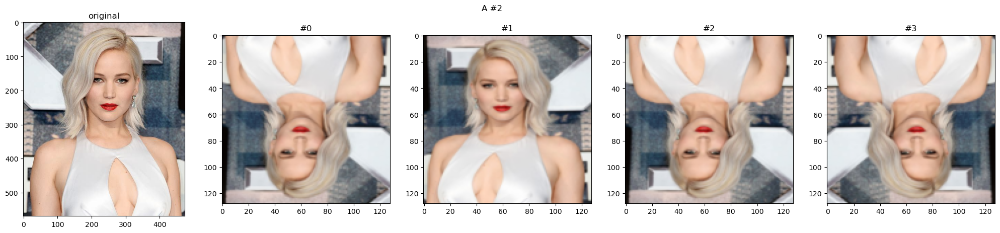

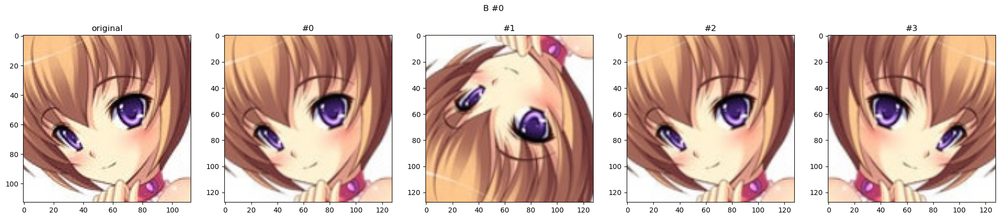

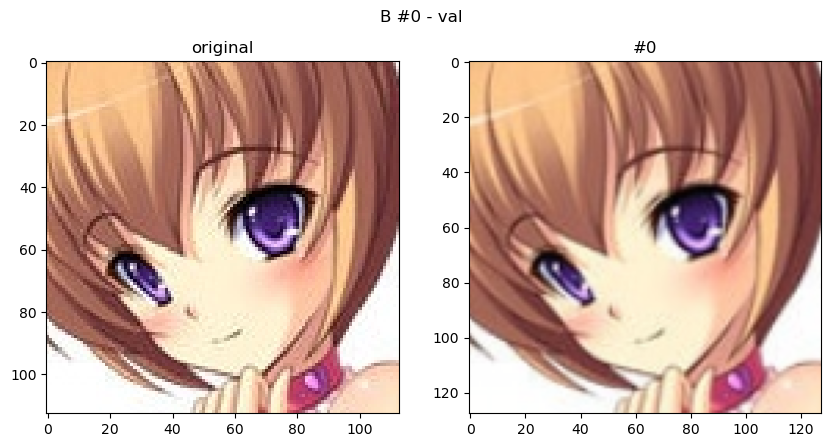

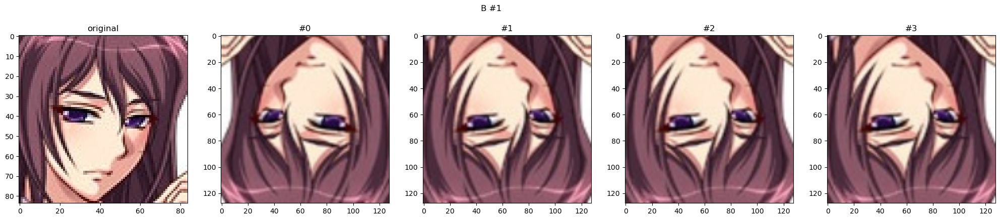

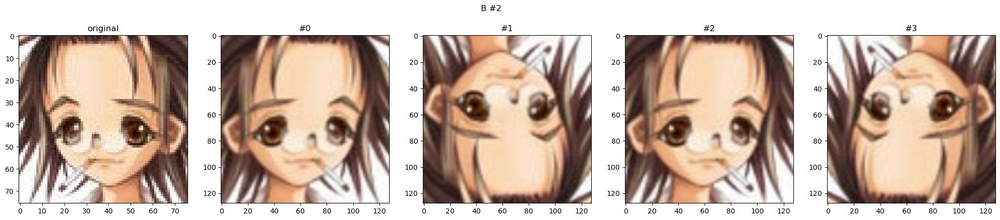

In [235]:
# Ваши гиперпараметры
hyperparams = dict(
    p = 0.5
)
# transform-ы для A и B
train_transform_a, val_transform_a, de_normalize_a = get_transforms(channel_mean_a, channel_std_a, **hyperparams)
train_transform_b, val_transform_b, de_normalize_b = get_transforms(channel_mean_b, channel_std_b, **hyperparams)

# Проверка на адекватность
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=0, title="A #0")
show_examples(ds.train_a, val_transform_a, de_normalize_a, num_per_image=1, image_index=0, title="A #0 - val")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=1, title="A #1")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=2, title="A #2")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=0, title="B #0")
show_examples(ds.train_b, val_transform_b, de_normalize_b, num_per_image=1, image_index=0, title="B #0 - val")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=1, title="B #1")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=2, title="B #2")

In [236]:
# Все датасеты с трансформами
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainA"),
        transform=train_transform_a,
    ),
    train_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainB"),
        transform=val_transform_b,
    ),
    test_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "testA"),
        transform=val_transform_a,
    ),
    test_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "testB"),
        transform=val_transform_b,
    ),
)

In [237]:
@dataclass
class DataLoadersClass:
    train_a: DataLoader
    train_b: DataLoader
    test_a: DataLoader
    test_b: DataLoader

batch_size = 1

dataloaders = DataLoadersClass(
    train_a=DataLoader(
        dataset=ds.train_a,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
    ),
    train_b=DataLoader(
        dataset=ds.train_b,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
    ),
    test_a=DataLoader(
        dataset=ds.test_a,
        batch_size=batch_size,
        shuffle=False,
        drop_last=True,
    ),
    test_b=DataLoader(
        dataset=ds.test_b,
        batch_size=batch_size,
        shuffle=False,
        drop_last=True,
    ),
)

In [238]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

results = []

model, optimizer_d, optimizer_g = create_model_and_optimizer(
    model_class = CycleGAN,
    model_params = {'img_channels': 3, 'device': device},
    lr = 1e-3,
    device = device,
)


scheduler_d = ExponentialLR(optimizer_d, gamma=0.9)
scheduler_g = ExponentialLR(optimizer_g, gamma=0.9)

criterion_d = FullDiscriminatorLoss()
criterion_g = FullGeneratorLoss()

sum_params, sum_learnable_params = model_num_params(model)

G_AB.initial_layer.0.weight                                       ~  9.408     params ~ grad: True
G_AB.initial_layer.0.bias                                         ~  64        params ~ grad: True
G_AB.downsampling_layers.0.conv.0.weight                          ~  73.728    params ~ grad: True
G_AB.downsampling_layers.0.conv.0.bias                            ~  128       params ~ grad: True
G_AB.downsampling_layers.1.conv.0.weight                          ~  294.912   params ~ grad: True
G_AB.downsampling_layers.1.conv.0.bias                            ~  256       params ~ grad: True
G_AB.residual_layers.0.block.0.conv.0.weight                      ~  589.824   params ~ grad: True
G_AB.residual_layers.0.block.0.conv.0.bias                        ~  256       params ~ grad: True
G_AB.residual_layers.0.block.1.conv.0.weight                      ~  589.824   params ~ grad: True
G_AB.residual_layers.0.block.1.conv.0.bias                        ~  256       params ~ grad: True
G_AB.resid

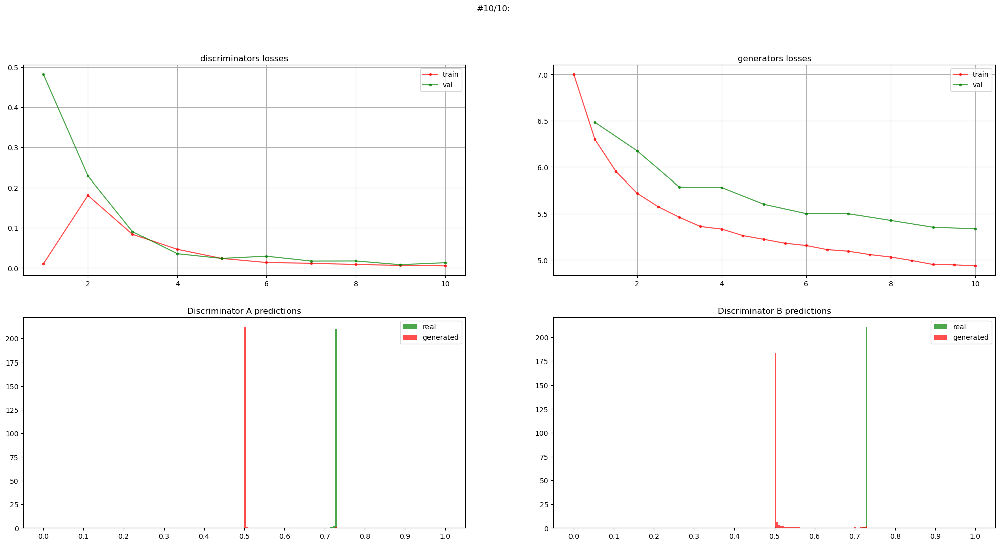

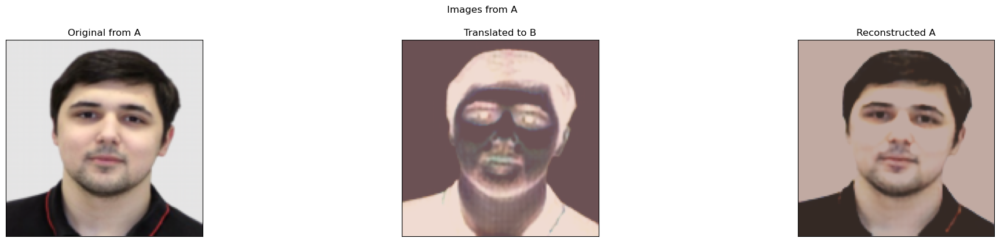

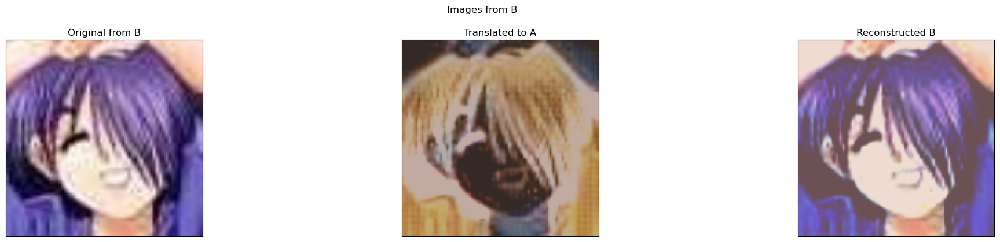

CPU times: total: 2h 54min 13s
Wall time: 29min 48s


In [239]:
%%time
model, optimizer_d, optimizer_g, plots = learning_loop(
    model = model,
    optimizer_g = optimizer_g,
    g_iters_per_epoch = 2,
    optimizer_d = optimizer_d,
    d_iters_per_epoch = 1,
    train_loader_a = dataloaders.train_a,
    train_loader_b = dataloaders.train_b,
    val_loader_a = dataloaders.test_a,
    val_loader_b = dataloaders.test_b,
    criterion_d = criterion_d,
    criterion_g = criterion_g,
    scheduler_g = scheduler_g,
    scheduler_d = scheduler_d,
    de_norm_a = de_normalize_a,
    de_norm_b = de_normalize_b,
    epochs = 10,
    min_lr = 1e-6,
    val_every = 1,
    draw_every = 1,
    chkp_folder = "./chkp",
    model_name = "cycle_gan",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
)

Видим, что модель очень хорошо научилась реконструировать начальное изображение

Посмотрим на примеры перевода изображений лица человека в аниме:

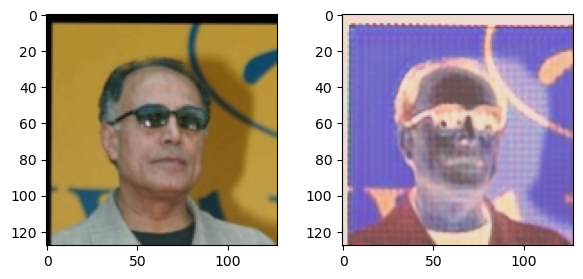

In [447]:
img_a = ds.test_a[15].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_AB(img_a)[0].cpu().detach()))

plt.show()

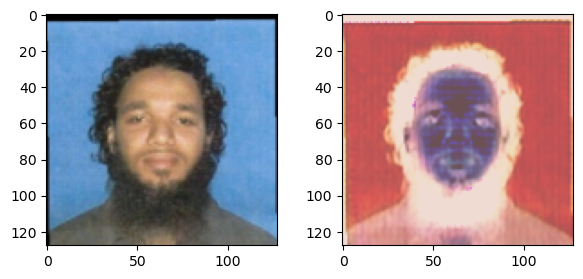

In [369]:
img_a = ds.test_a[127].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_AB(img_a)[0].cpu().detach()))

plt.show()

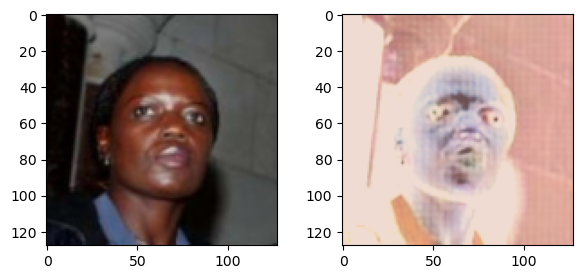

In [498]:
img_a = ds.test_a[251].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_AB(img_a)[0].cpu().detach()))

plt.show()

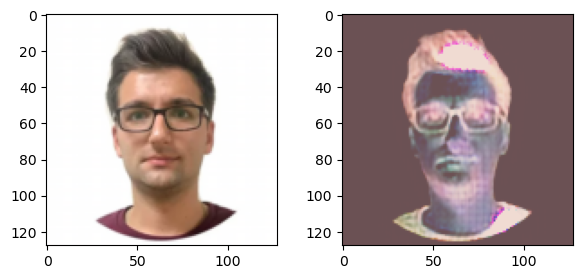

In [496]:
img_a = ds.test_a[254].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(7, 3))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_AB(img_a)[0].cpu().detach()))

plt.show()

**Вывод: Видим, что модель скорее научилась делать фотографии в стиле поп-арт, а для стилизации использовать яркие цвета волос и кожи как у картинок аниме :)** Для решения этой загвоздки можно попробовать использовать парные датасеты или же увеличить объем выборок